## Environment set up and import Libraries

In [96]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [97]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
with tf.device(device_name):
  print(device_name.split(":")[1]," running . . . ")

GPU  running . . . 


In [98]:
import tensorflow as tf
import os,sys
import numpy as np
import random

random.seed(1)
np.random.seed(1)
tf.random.set_seed(2)

In [99]:
import os, keras, numpy,tensorflow
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from numpy import *
from numpy.random import *
from keras.datasets.fashion_mnist import load_data
from keras.datasets import mnist
from tensorflow.keras.optimizers import Adam
from keras.models import Model
from keras.layers import *
from tensorflow.keras import initializers

## **Discriminator** Model

In [100]:
def define_discriminator(in_shape=(128,128,3),n_classes=5):

    # input level
    label_layer_1 = Input(shape=(1,), name = "input_label")
    label_layer_2 = Embedding(n_classes, 200)(label_layer_1)
    label_layer_3 = Dense(in_shape[0] * in_shape[1])(label_layer_2)
    label_layer_4 = Reshape((in_shape[0], in_shape[1], 1))(label_layer_3)
    # (128, 128, 1)

    # input image
    input_image = Input(shape=in_shape, name = "input_image")
    # (128, 128, 3)

    concat_layer = Concatenate()([input_image, label_layer_4])
    # (128, 128, 4)

    conv2d_layer_1 = Conv2D(filters = 16, kernel_size = (3,3), strides = (2,2), padding='same')(concat_layer)
    conv2d_layer_1 = LeakyReLU(alpha=0.3)(conv2d_layer_1)
    # (64, 64, 16)

    conv2d_layer_2 = Conv2D(filters = 32, kernel_size = (3,3), strides = (2,2), padding = 'same')(conv2d_layer_1)
    conv2d_layer_2 = LeakyReLU(alpha=0.3)(conv2d_layer_2)
    # (32, 32, 32)

    # label_layer_3_1 = Dense(32 * 32)(label_layer_2)
    # label_layer_4_1 = Reshape((32, 32, 1))(label_layer_3_1)
    # (32, 32, 1)

    # concat_layer_1 = Concatenate()([conv2d_layer_2, label_layer_4_1])
    # (32, 32, 33)

    conv2d_layer_3 = Conv2D(filters = 64, kernel_size = (3,3),  strides = (2,2), padding = 'same')(conv2d_layer_2)
    conv2d_layer_3 = LeakyReLU(alpha=0.3)(conv2d_layer_3)
    # (16, 16, 64)

    conv2d_layer_4 = Conv2D(filters = 128, kernel_size = (3,3), strides = (2,2), padding = 'same')(conv2d_layer_3)
    conv2d_layer_4 = LeakyReLU(alpha=0.3)(conv2d_layer_4)
    # (8, 8, 128)

    conv2d_layer_5 = Conv2D(filters = 128, kernel_size = (3,3), strides = (2,2), padding = 'same')(conv2d_layer_4)
    conv2d_layer_5 = LeakyReLU(alpha=0.3)(conv2d_layer_5)
    # (4, 4, 256)

    flatten_layer = Flatten()(conv2d_layer_5)
    # (4 * 4 * 256)

    dropout_layer = Dropout(rate=0.4)(flatten_layer)
    # (4 * 4 * 256)

    dense_layer = Dense(128 * 8 * 2, activation='relu')(dropout_layer)
    # (8 * 128 * 2)

    # final layer
    output_layer = Dense(1, activation='linear')(dense_layer)
    # (1,)

    model = Model([input_image,label_layer_1], output_layer)

    opt = Adam(learning_rate= 3e-4, beta_1=0.05, beta_2=0.05)
    model.compile(loss='mse', optimizer=opt, metrics=['accuracy'])
    return model

a = define_discriminator()
a.summary()

Model: "model_30"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_label (InputLayer)       [(None, 1)]          0           []                               
                                                                                                  
 embedding_20 (Embedding)       (None, 1, 200)       1000        ['input_label[0][0]']            
                                                                                                  
 dense_50 (Dense)               (None, 1, 16384)     3293184     ['embedding_20[0][0]']           
                                                                                                  
 input_image (InputLayer)       [(None, 128, 128, 3  0           []                               
                                )]                                                         

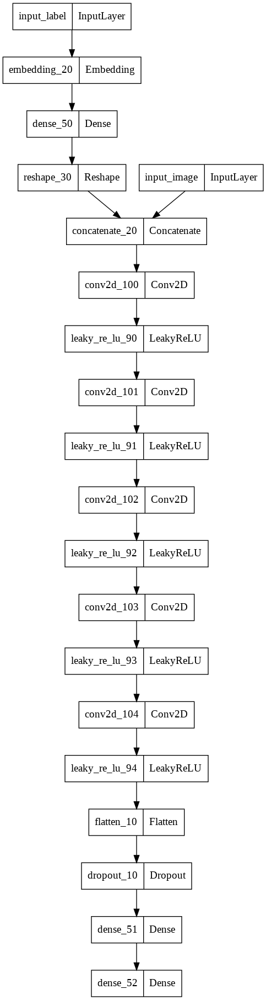

In [101]:
# plot the discriminator model
tf.keras.utils.plot_model(a)

## **Generator** Model

In [102]:
def define_generator(latent_dim = 100, n_classes = 5):

    # input level
    label_layer_1 = Input(shape=(1,), name = "input_label")
    label_layer_2 = Embedding(n_classes, 200)(label_layer_1)
    label_layer_3 = Dense(8 * 8)(label_layer_2)
    label_layer_4 = Reshape((8, 8, 1))(label_layer_3)
    # (8, 8, 1)

    # latent input
    latent_layer = Input(shape=(latent_dim,), name = "input_latent")

    layer_2 = Dense(128 * 8 * 8)(latent_layer)
    layer_2 = Activation("relu")(layer_2)
    layer_2 = Reshape((8, 8, 128))(layer_2)
    layer_2_1 = BatchNormalization(momentum = 0.8)(layer_2)
    # (8, 8, 128)


    concat_layer_1 = Concatenate()([layer_2_1, label_layer_4])
    # (8, 8, 129)

    layer_3 = Conv2DTranspose(filters = 64, kernel_size = (3,3), strides=(2,2), padding='same')(concat_layer_1)
    layer_3 = Conv2D(filters = 64, kernel_size = (3,3), padding='same', kernel_initializer = initializers.RandomNormal(0,0.8))(layer_3)
    layer_3 = BatchNormalization(momentum = 0.8)(layer_3)
    layer_3 = LeakyReLU(alpha=0.4)(layer_3)
    # (16, 16, 64)

    layer_4 = Conv2DTranspose(filters = 64, kernel_size = (3,3), strides=(2,2), padding='same')(layer_3)
    layer_4 = Conv2D(filters = 64, kernel_size = (3,3), padding='same',kernel_initializer = initializers.RandomNormal(0,0.8))(layer_4)
    layer_4 = BatchNormalization(momentum = 0.8)(layer_4)
    layer_4 = LeakyReLU(alpha=0.4)(layer_4)
    # (32, 32, 64)

    # label_layer_2_1 = Embedding(n_classes, 100)(label_layer_1)
    # label_layer_3_1 = Dense(32 * 32)(label_layer_2)
    # label_layer_4_1 = Reshape((32, 32, 1))(label_layer_3_1)
    # label_layer_5_1 = BatchNormalization(momentum = 0.8)(label_layer_4_1)
    # (32, 32, 1)

    # concat_layer_2 = Concatenate()([layer_4, label_layer_4_1])
    # (32, 32, 65)


    layer_5 = Conv2DTranspose(filters = 64, kernel_size = (3,3), strides=(2,2), padding='same')(layer_4)
    layer_5 = Conv2D(filters = 64, kernel_size = (3,3), padding='same',kernel_initializer = initializers.RandomNormal(0,0.8))(layer_5)
    layer_5 = BatchNormalization(momentum = 0.8)(layer_5)
    layer_5 = LeakyReLU(alpha=0.4)(layer_5)
    # (64, 64, 64)

    layer_6 = Conv2DTranspose(filters = 64, kernel_size = (3,3), strides=(2,2), padding='same')(layer_5)
    layer_6 = Conv2D(filters = 64, kernel_size = (3,3), padding='same',kernel_initializer = initializers.RandomNormal(0,0.8))(layer_6)
    layer_6 = BatchNormalization(momentum = 0.8)(layer_6)
    layer_6 = LeakyReLU(alpha=0.4)(layer_6)
    # (128, 128, 64)

    # final layer
    output_layer = Conv2D(filters = 3, kernel_size = (3,3), strides=(1,1), activation='tanh', padding='same')(layer_6)

    model = Model([latent_layer,label_layer_1], output_layer)
    return model

b = define_generator(512)
b.summary()

Model: "model_31"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_latent (InputLayer)      [(None, 512)]        0           []                               
                                                                                                  
 dense_54 (Dense)               (None, 8192)         4202496     ['input_latent[0][0]']           
                                                                                                  
 input_label (InputLayer)       [(None, 1)]          0           []                               
                                                                                                  
 activation_10 (Activation)     (None, 8192)         0           ['dense_54[0][0]']               
                                                                                           

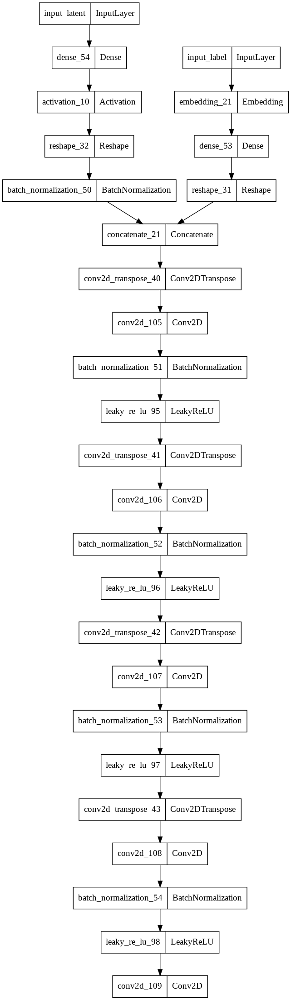

In [103]:
# plot the generator model
tf.keras.utils.plot_model(b)

## **Combine** or **GAN** Model

In [104]:
def define_gan(g_model, d_model):

  d_model.trainable = False

  g_latent, g_label = g_model.input
  g_output = g_model.output

  d_output = d_model([g_output,g_label])

  model = Model([g_latent, g_label], d_output)

  opt = Adam(learning_rate= 3e-4, beta_1=0.05, beta_2=0.05)
  model.compile(loss='mse', optimizer=opt,  metrics=['accuracy'])
  
  return model
c = define_gan(b, a)
c.summary()

Model: "model_32"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_latent (InputLayer)      [(None, 512)]        0           []                               
                                                                                                  
 dense_54 (Dense)               (None, 8192)         4202496     ['input_latent[0][0]']           
                                                                                                  
 input_label (InputLayer)       [(None, 1)]          0           []                               
                                                                                                  
 activation_10 (Activation)     (None, 8192)         0           ['dense_54[0][0]']               
                                                                                           

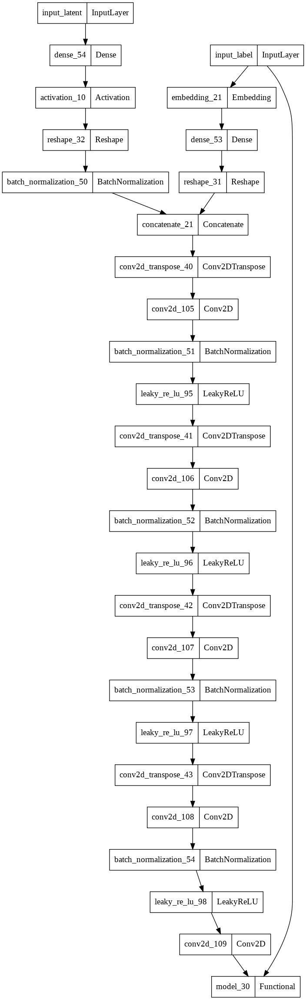

In [105]:
# plot GAN model
tf.keras.utils.plot_model(c)

## Load Dataset

In [106]:
def load_real_samples():
  # load dataset
  data = np.load("/content/drive/MyDrive/GAN_New_Approch/abstract_independence.npz")
  data = data['a']
  data = np.array(data)
  X = data.astype('float32')
  # scale from [0,255] to [-1,1]
  X = (X - 127.5) / 127.5
  return X
# k = load_real_samples()
# print("image: ",k.shape)
# print("\nshape/size of the first 16 data: ",k[:16].shape)

## Plot data with label

In [107]:
def save_plot(x_input,n=4):
    # plt.figure(figsize=(15,7))
    for i in range(n*n):
        plt.subplot(n, n, i+1)
        plt.imshow(x_input[i,:,:,:])
        plt.axis('off')
    plt.show()
# plot data
# save_plot(k[:16])

## Generate real sample function

In [108]:
def generate_real_samples(dataset, n_samples):
	images = dataset
	ix = randint(0, images.shape[0], n_samples)
	X = images[ix]
	z = np.random.randint(0,5,size=(n_samples))
	y = ones((n_samples, 1))
	return [X,z], y
# d = generate_real_samples(k, 32)
# print("Generate real data as a batch randomly: ",d[0][0].shape)

## Generate latent point function

In [109]:
def generate_latent_points(latent_dim, n_samples):
  x_input = randn(latent_dim * n_samples)
  z_input = x_input.reshape(n_samples, latent_dim)
  z = np.random.randint(0,5,size=(n_samples))
  return [z_input,z]
# p = generate_latent_points(512, 32)
# print("Generate latent point(with label) as a batch: ",p[0].shape)

## Generate Fake samples of image with label

In [110]:
def generate_fake_samples(generator, latent_dim, n_samples):
	z_input,z = generate_latent_points(latent_dim, n_samples)
	images = generator.predict([z_input,z])
	y = zeros((n_samples, 1))
	return [images, z], y
# with tf.device(device_name):
	# kh = generate_fake_samples(b, 512, 32)
	# print("shape of the generated images: ",kh[0][0].shape)

## Summarize the generator model

In [111]:
def summarize_the_model(generator,latent_dim = 100):
    latent_points = generate_latent_points(latent_dim= latent_dim, n_samples= 16)
    X  = generator.predict(latent_points)
    # scale from [-1,1] to [0,1]
    X = (X + 1) / 2.0
    save_plot(X, n=4)

In [112]:
# def save_figure(generator,a,latent_dim = 512,n=4):
#     latent_points, labels = generate_latent_points(latent_dim= latent_dim, n_samples= 16)
#     X  = generator.predict([latent_points, labels])
#     X = (X + 1) / 2.0
#     # plt.title("Epoch_"+str(a+1),loc = "center")
#     plt.figure(figsize=(15,7))
#     for j in range(n*n):
#         plt.subplot(n, n, j+1)
#         plt.imshow(X[j,:,:,:])
#         plt.axis('off')
#     plt.suptitle("Epoch_"+str(a+1))
#     # plt.savefig("/content/drive/MyDrive/GAN_New_Approch/LSGAN/Epoch_"+str(a+1))

## Train function

In [113]:
def train(g_model, d_model, gan_model, dataset, latent_dim= 100, n_epochs=3, n_batch=128):

  print("No. of epoch: ",n_epochs)
  bat_per_epo = int(dataset.shape[0] / n_batch)
  print("Dataset Size: ",dataset.shape[0])
  print("No. Of Batch: ", bat_per_epo)
  print("Mini Batch: ")
  print("Full Batch: ",n_batch)
  half_batch = int(n_batch / 2)
  print("Half Batch: ", half_batch,'\n')
  print("*"*50,'\n\n')

  d_loss_real_array,d_loss_fake_array =[],[]
  g_loss_array = []
  for i in range(n_epochs):
    d_loss_r,d_loss_f = 0.0,0.0
    g_loss = 0.0
    
    for j in range(bat_per_epo):

      [X_real, labels_real], y_real = generate_real_samples(dataset, half_batch)
      d_loss1, _ = d_model.train_on_batch([X_real, labels_real], y_real)
      d_loss_r += (d_loss1 / half_batch)
      # print("real_loss")

      [X_fake, labels], y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
      d_loss2, _ = d_model.train_on_batch([X_fake, labels], y_fake)
      d_loss_f += (d_loss2 / half_batch)
      # print("fake_loss")

      [z_input, labels_input] = generate_latent_points(latent_dim, n_batch)
      y_gan = ones((n_batch, 1))
      g_loss1,_ = gan_model.train_on_batch([z_input, labels_input], y_gan)
      g_loss += (g_loss1 / n_batch)

    d_loss_real_array.append(d_loss_r / bat_per_epo)
    d_loss_fake_array.append(d_loss_f / bat_per_epo)
    g_loss_array.append(g_loss / bat_per_epo)

    print('epoch -> [%d/%d], discriminator_loss_for_real_data = %.2f, discriminator_loss_for_fake_data = %.2f, generator_loss = %.2f\n' %(i+1, n_epochs, d_loss_r/bat_per_epo, d_loss_f/bat_per_epo, g_loss/bat_per_epo))
    # if(i%20==0):
    summarize_the_model(g_model,latent_dim)    
    # save_figure(g_model,i,latent_dim = 512,n=4)
    # g_model.save("g_gan_model_"+str(i)+".h5")
    g_model.save("/content/drive/MyDrive/GAN_New_Approch/LSGAN_Abstract_1/generator_model.h5")
    np.savez_compressed('/content/drive/MyDrive/GAN_New_Approch/LSGAN_Abstract_1/loss_record.npz', a=d_loss_real_array, b=d_loss_fake_array, c=g_loss_array)
    # save_figure(g_model,i,latent_dim = 512,n=4)

    print("\n")

  return d_loss_real_array, d_loss_fake_array, g_loss_array

## Main function


READY TO GO !!!

No. of epoch:  200
Dataset Size:  8235
No. Of Batch:  257
Mini Batch: 
Full Batch:  32
Half Batch:  16 

************************************************** 


epoch -> [1/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.03



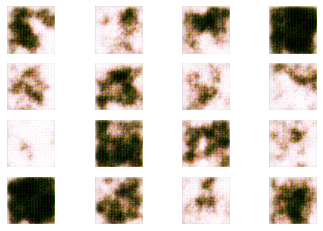



epoch -> [2/200], discriminator_loss_for_real_data = 0.03, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



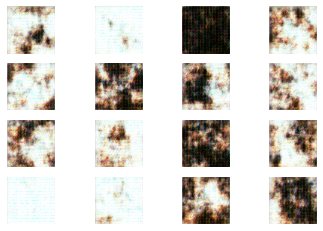



epoch -> [3/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



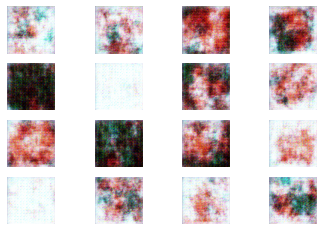



epoch -> [4/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.02, generator_loss = 0.01



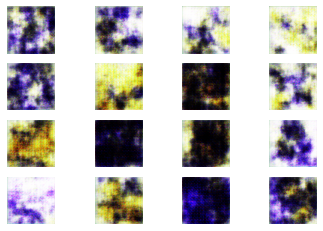



epoch -> [5/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



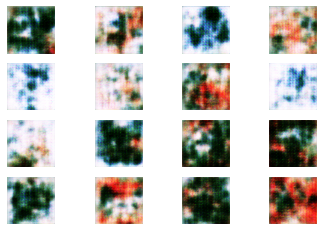



epoch -> [6/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



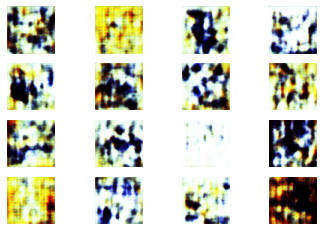



epoch -> [7/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



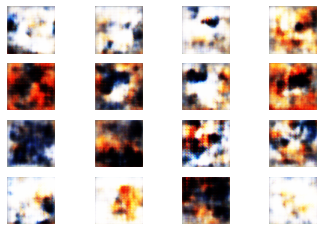



epoch -> [8/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



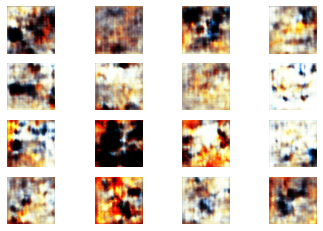



epoch -> [9/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



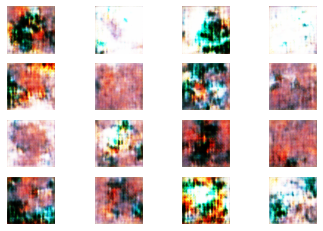



epoch -> [10/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



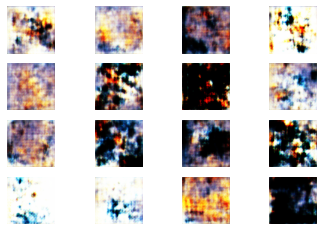



epoch -> [11/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



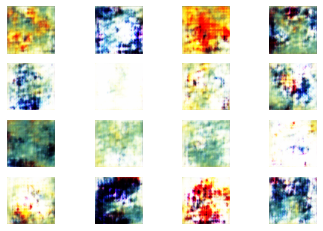



epoch -> [12/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



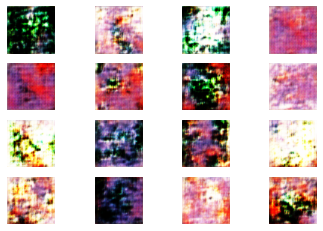



epoch -> [13/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



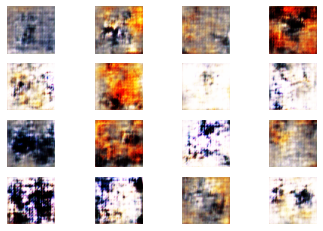



epoch -> [14/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



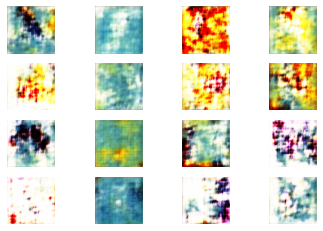



epoch -> [15/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



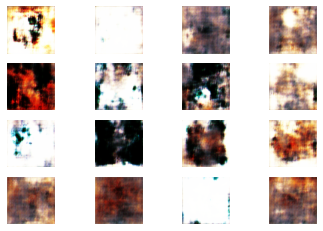



epoch -> [16/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



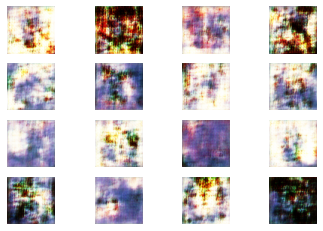



epoch -> [17/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



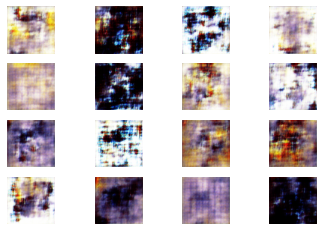



epoch -> [18/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



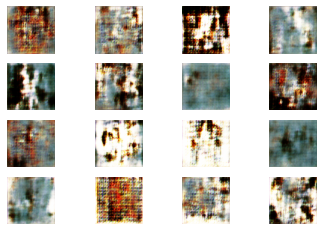



epoch -> [19/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



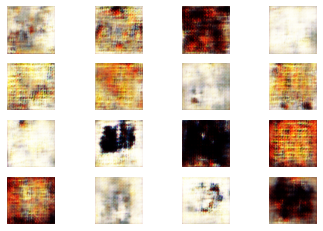



epoch -> [20/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



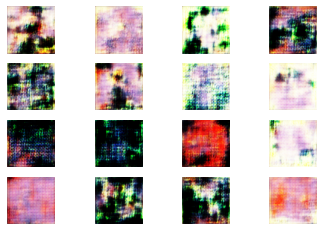



epoch -> [21/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



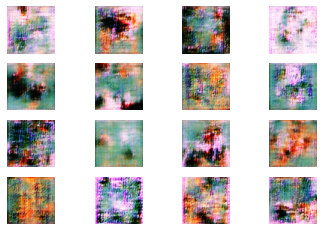



epoch -> [22/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



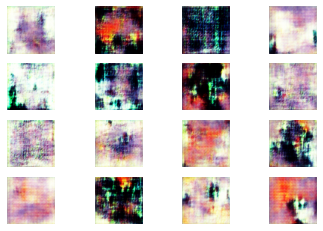



epoch -> [23/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



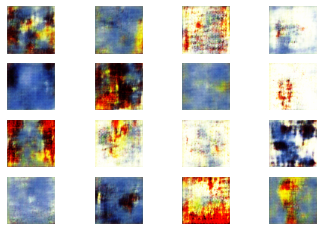



epoch -> [24/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



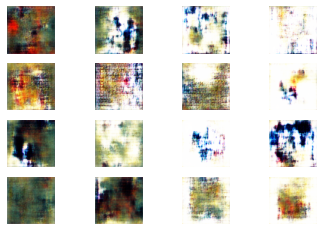



epoch -> [25/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



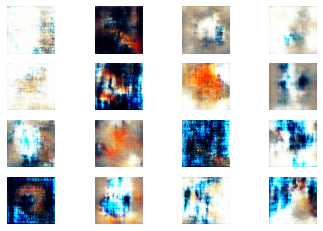



epoch -> [26/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



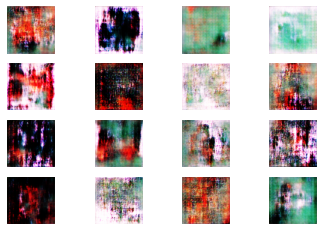



epoch -> [27/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



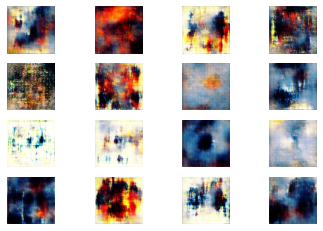



epoch -> [28/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



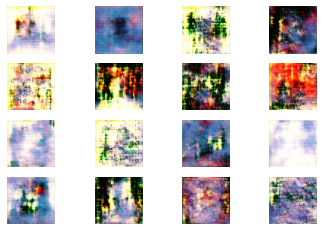



epoch -> [29/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



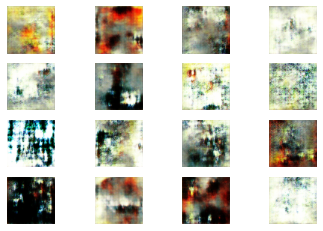



epoch -> [30/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



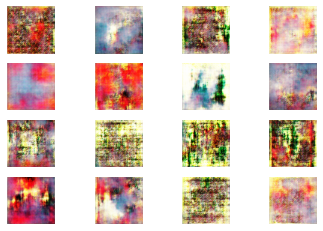



epoch -> [31/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



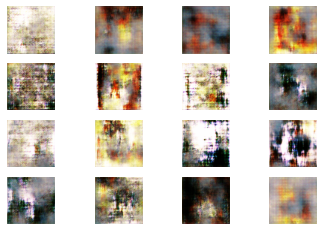



epoch -> [32/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



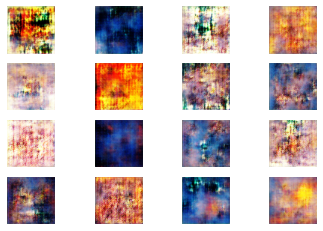



epoch -> [33/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



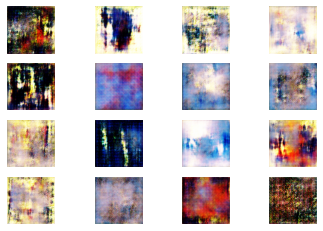



epoch -> [34/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



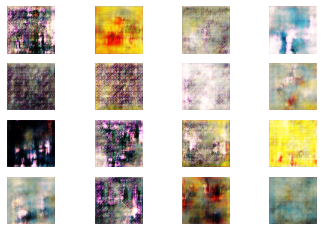



epoch -> [35/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



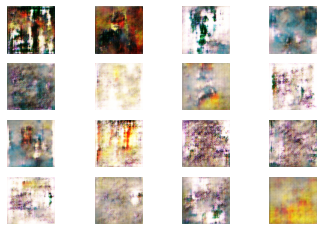



epoch -> [36/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



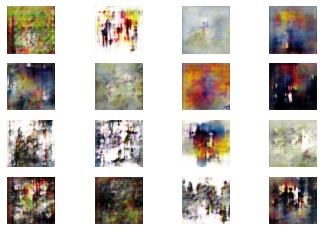



epoch -> [37/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



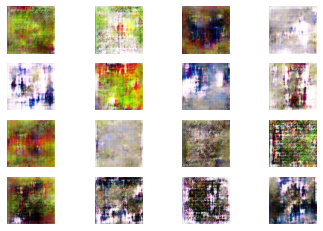



epoch -> [38/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



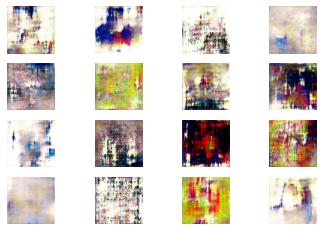



epoch -> [39/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



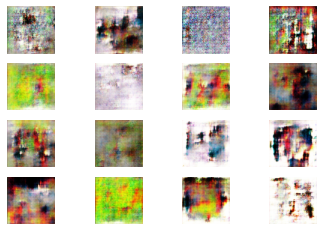



epoch -> [40/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



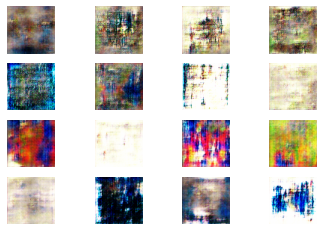



epoch -> [41/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



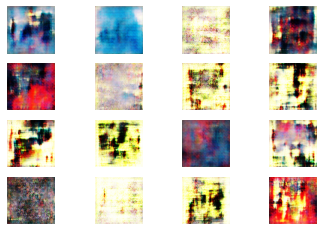



epoch -> [42/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



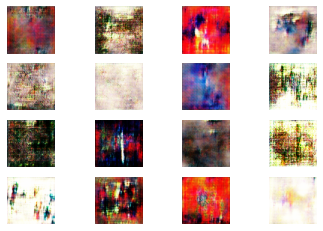



epoch -> [43/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



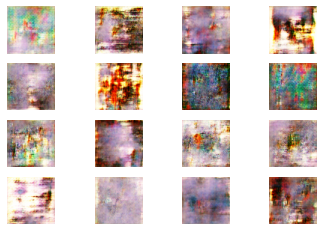



epoch -> [44/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



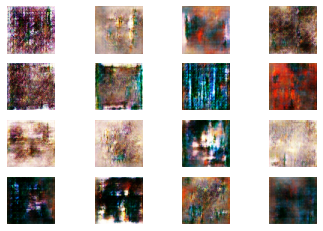



epoch -> [45/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



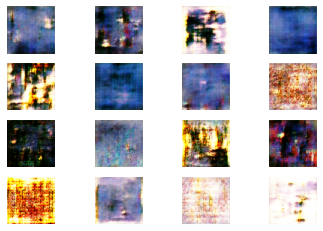



epoch -> [46/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



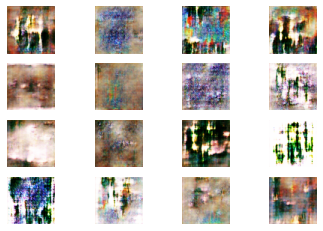



epoch -> [47/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



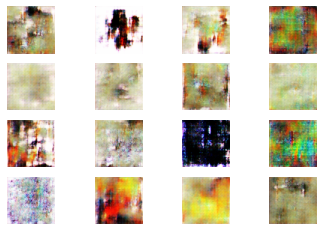



epoch -> [48/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



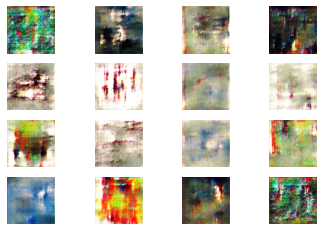



epoch -> [49/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



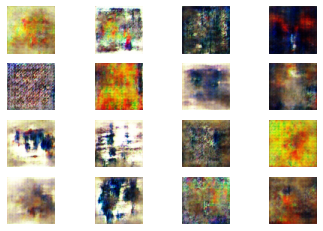



epoch -> [50/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



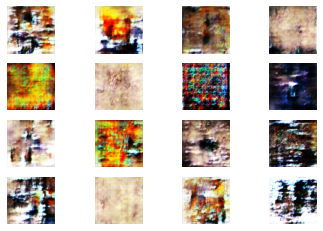



epoch -> [51/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



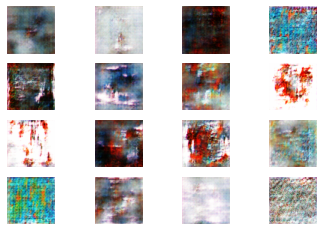



epoch -> [52/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



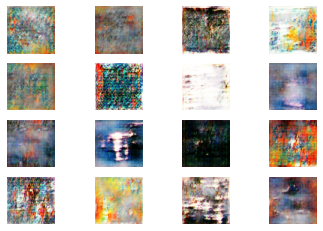



epoch -> [53/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



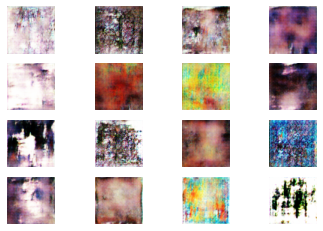



epoch -> [54/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



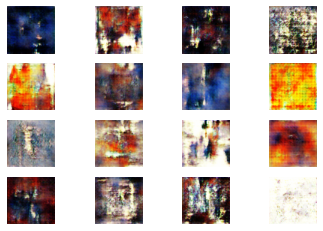



epoch -> [55/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



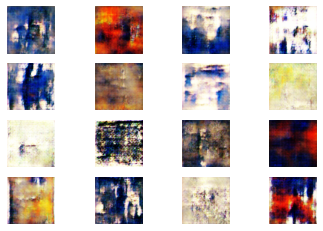



epoch -> [56/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



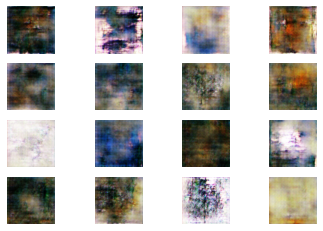



epoch -> [57/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



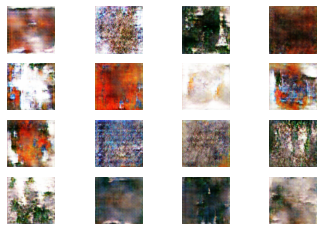



epoch -> [58/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



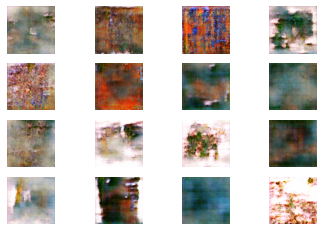



epoch -> [59/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



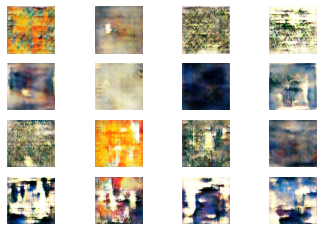



epoch -> [60/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



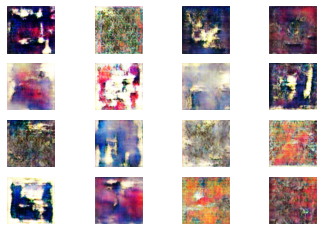



epoch -> [61/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



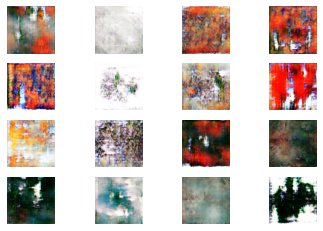



epoch -> [62/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



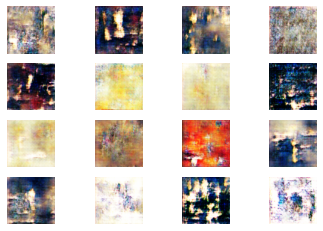



epoch -> [63/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



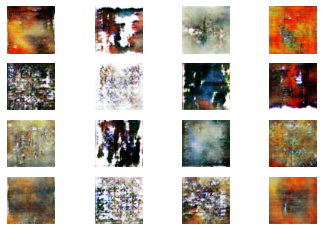



epoch -> [64/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



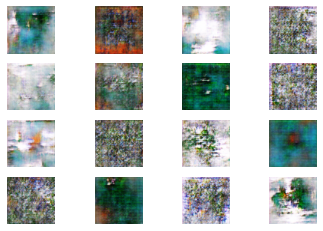



epoch -> [65/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



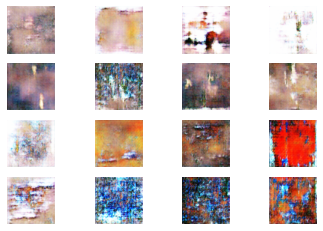



epoch -> [66/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



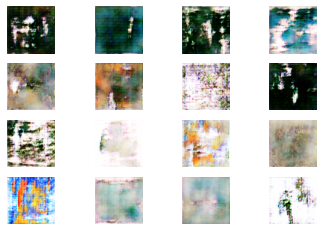



epoch -> [67/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



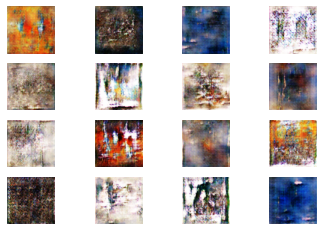



epoch -> [68/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



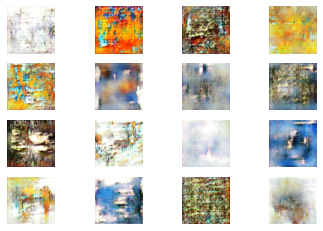



epoch -> [69/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



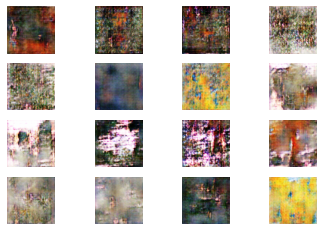



epoch -> [70/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



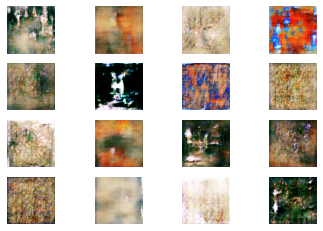



epoch -> [71/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



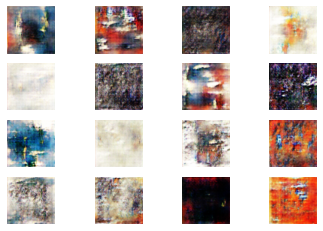



epoch -> [72/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



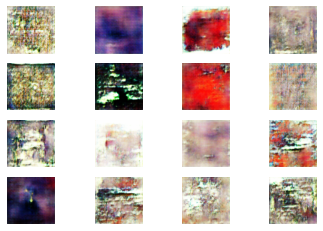



epoch -> [73/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



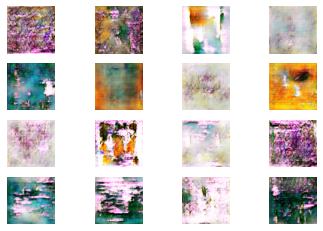



epoch -> [74/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



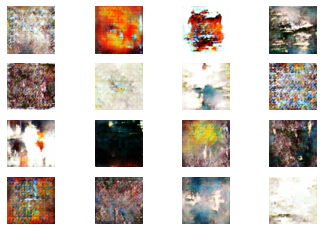



epoch -> [75/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



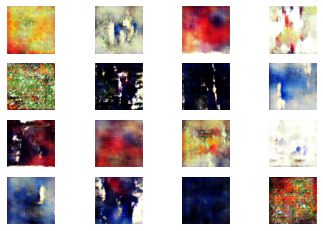



epoch -> [76/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



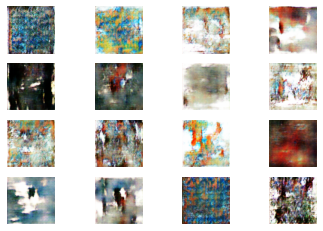



epoch -> [77/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



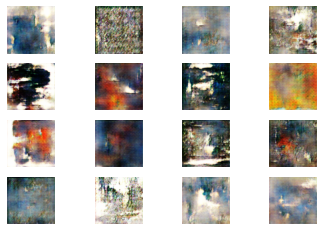



epoch -> [78/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



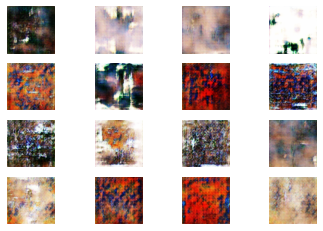



epoch -> [79/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



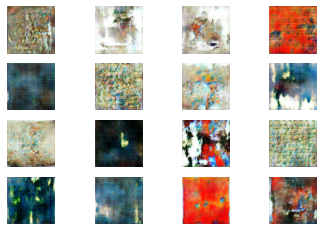



epoch -> [80/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



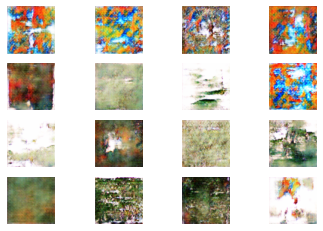



epoch -> [81/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



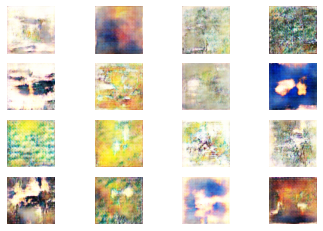



epoch -> [82/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



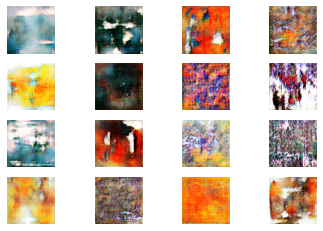



epoch -> [83/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



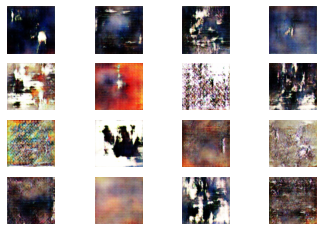



epoch -> [84/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



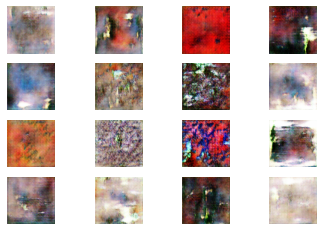



epoch -> [85/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



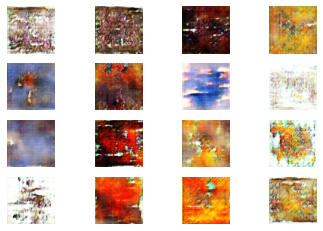



epoch -> [86/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



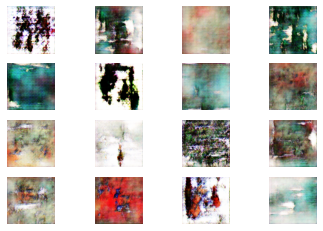



epoch -> [87/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



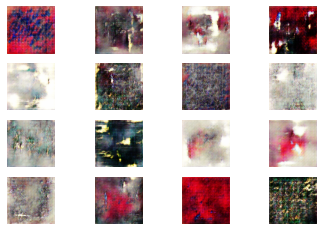



epoch -> [88/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



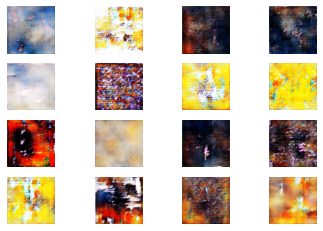



epoch -> [89/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



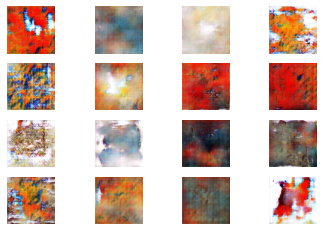



epoch -> [90/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



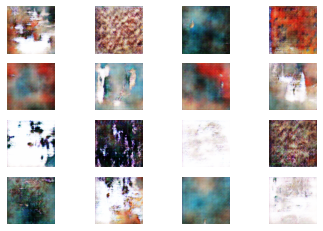



epoch -> [91/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



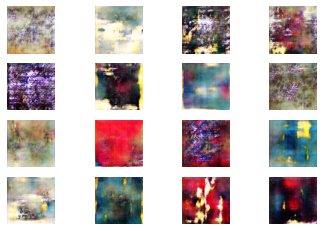



epoch -> [92/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



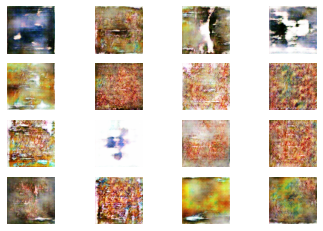



epoch -> [93/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



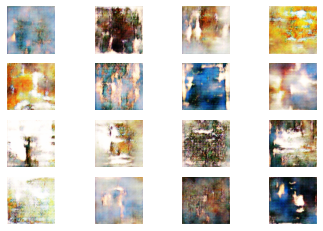



epoch -> [94/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



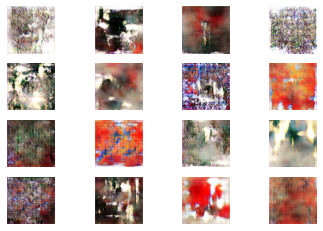



epoch -> [95/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



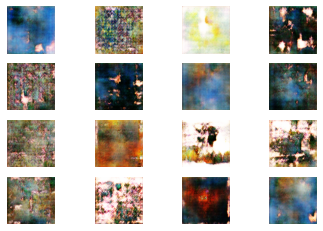



epoch -> [96/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



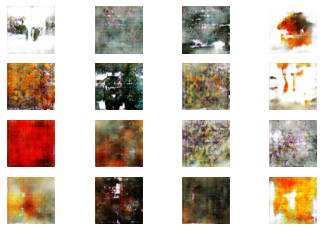



epoch -> [97/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



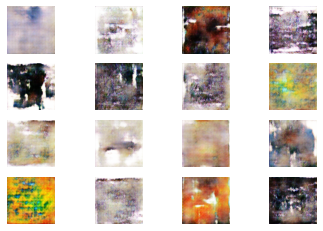



epoch -> [98/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



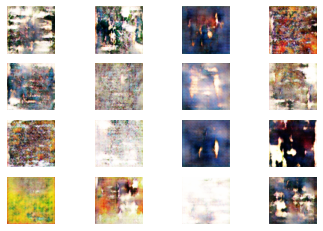



epoch -> [99/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



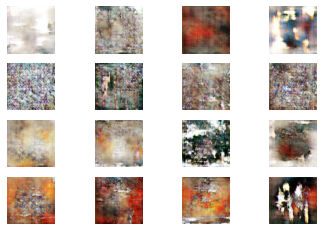



epoch -> [100/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



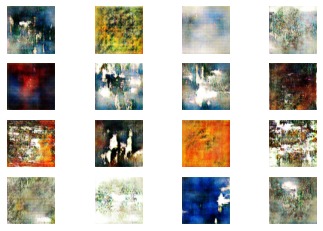



epoch -> [101/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



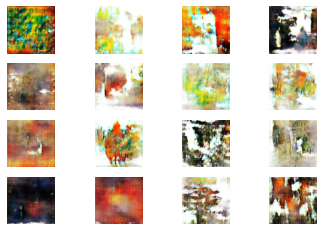



epoch -> [102/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



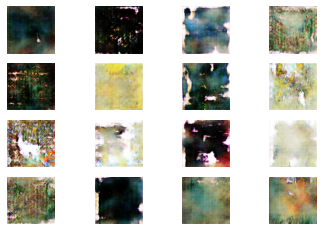



epoch -> [103/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



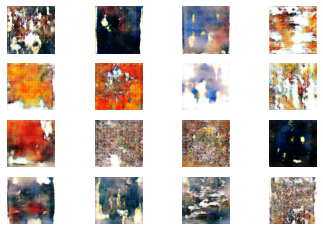



epoch -> [104/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



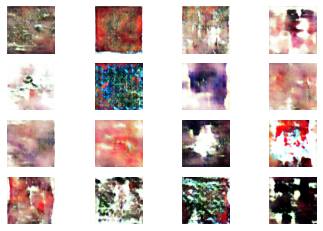



epoch -> [105/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



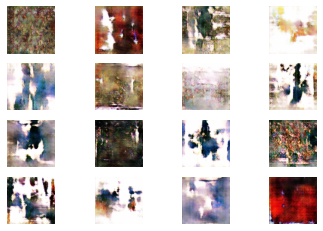



epoch -> [106/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



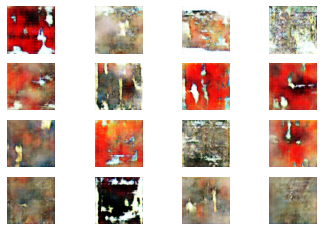



epoch -> [107/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



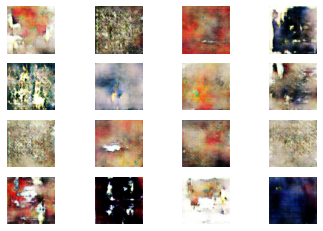



epoch -> [108/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



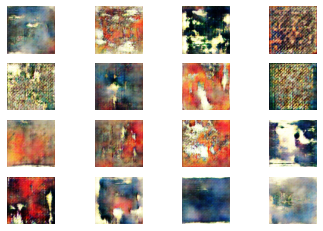



epoch -> [109/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



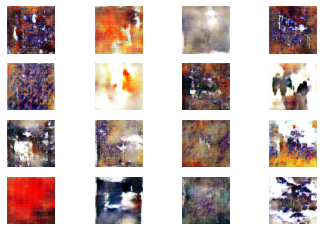



epoch -> [110/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



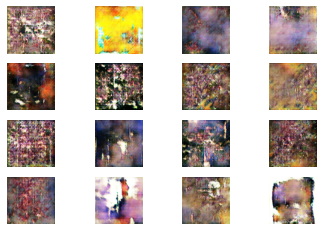



epoch -> [111/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



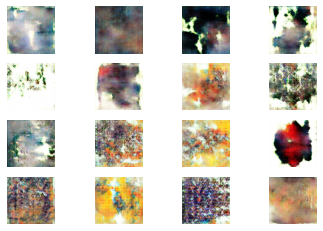



epoch -> [112/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



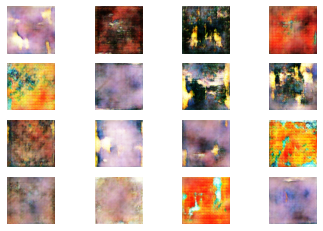



epoch -> [113/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



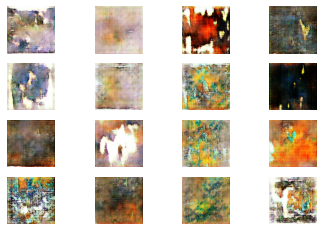



epoch -> [114/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



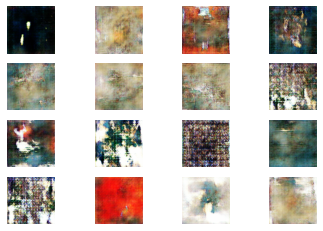



epoch -> [115/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



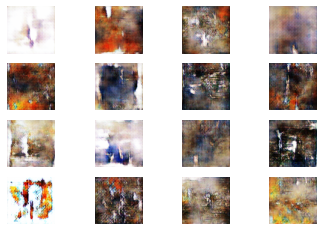



epoch -> [116/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



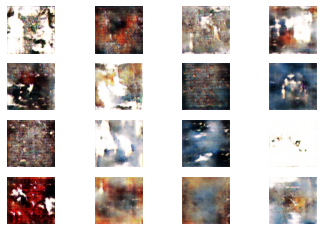



epoch -> [117/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



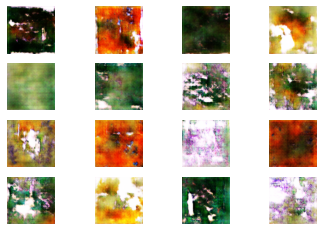



epoch -> [118/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



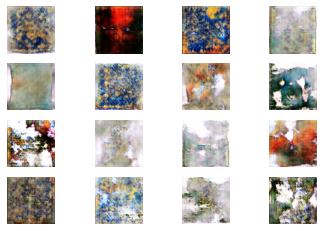



epoch -> [119/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



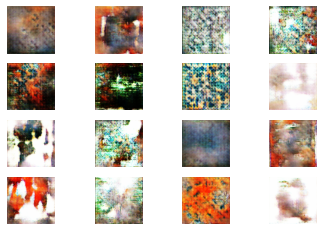



epoch -> [120/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



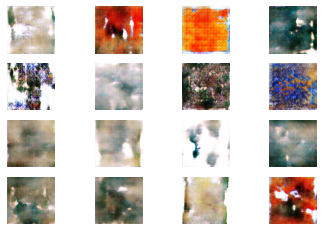



epoch -> [121/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



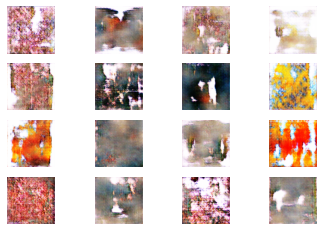



epoch -> [122/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



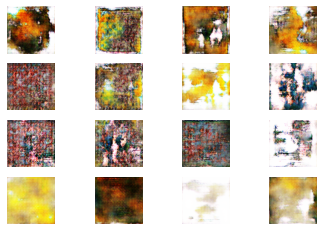



epoch -> [123/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



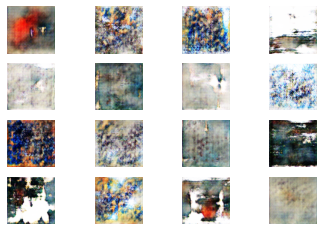



epoch -> [124/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



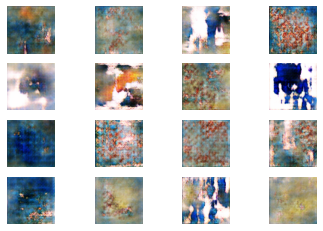



epoch -> [125/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



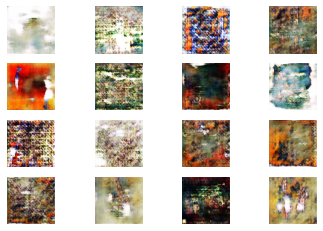



epoch -> [126/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



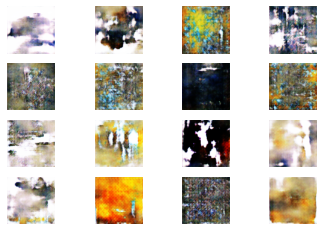



epoch -> [127/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



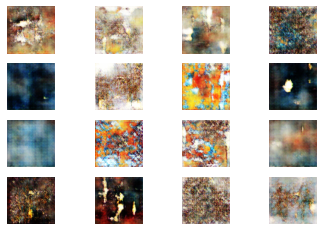



epoch -> [128/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



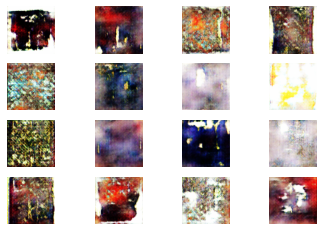



epoch -> [129/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



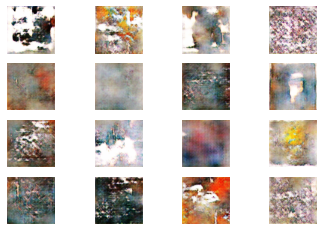



epoch -> [130/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



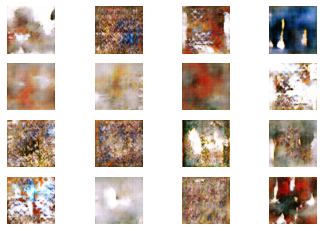



epoch -> [131/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



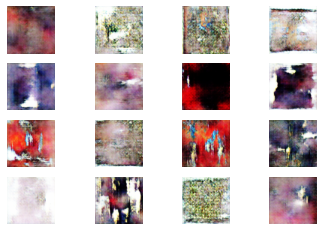



epoch -> [132/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



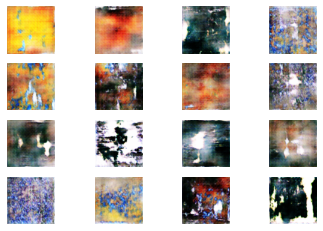



epoch -> [133/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.02



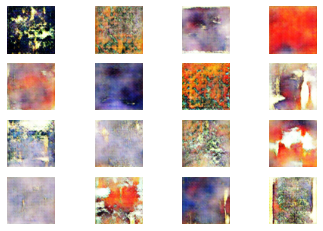



epoch -> [134/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



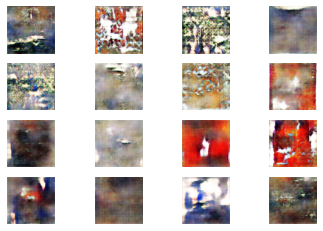



epoch -> [135/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



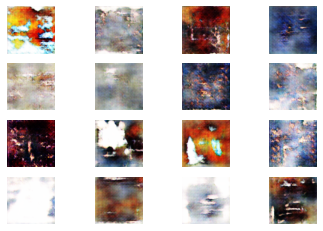



epoch -> [136/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



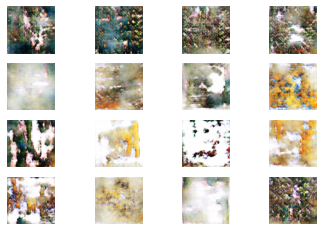



epoch -> [137/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



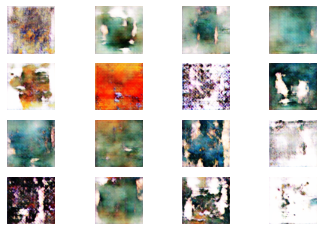



epoch -> [138/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



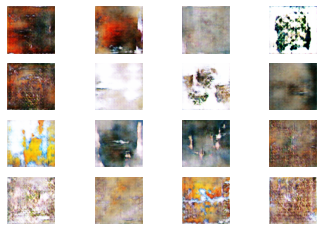



epoch -> [139/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



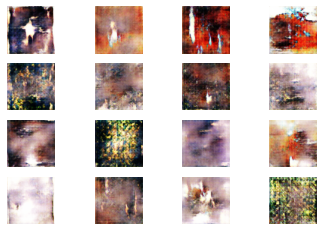



epoch -> [140/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



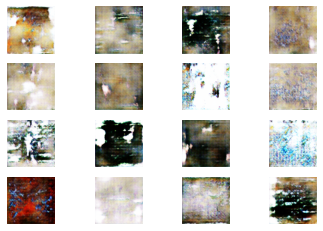



epoch -> [141/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



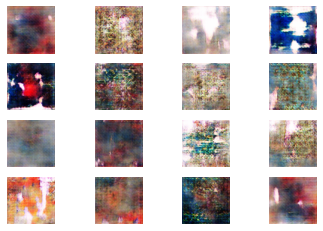



epoch -> [142/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



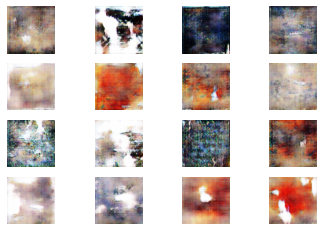



epoch -> [143/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



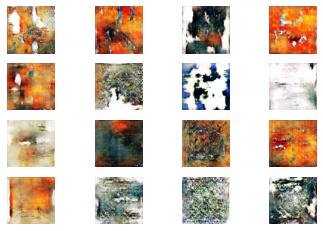



epoch -> [144/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



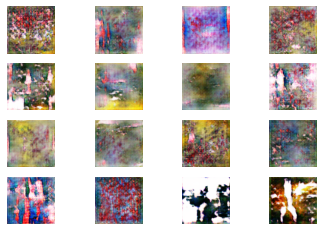



epoch -> [145/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



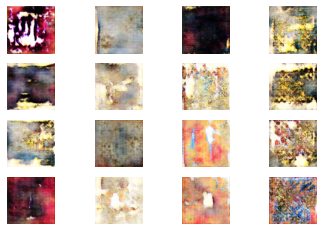



epoch -> [146/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



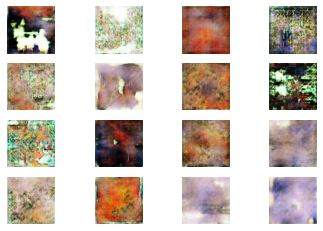



epoch -> [147/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



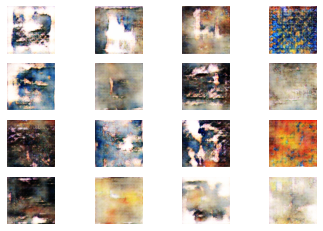



epoch -> [148/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



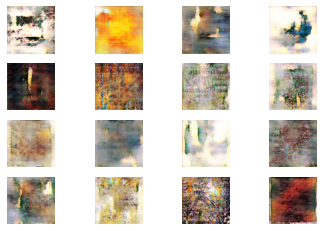



epoch -> [149/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



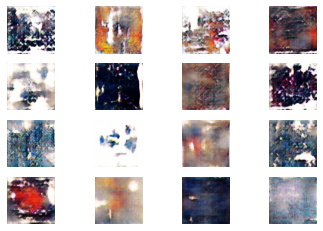



epoch -> [150/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



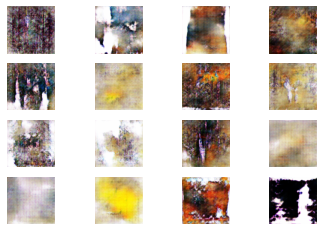



epoch -> [151/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



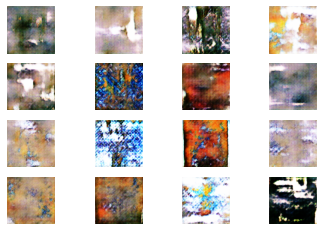



epoch -> [152/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



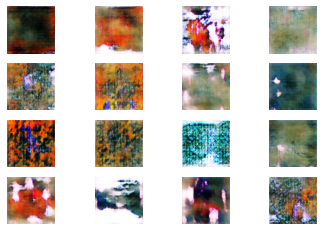



epoch -> [153/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



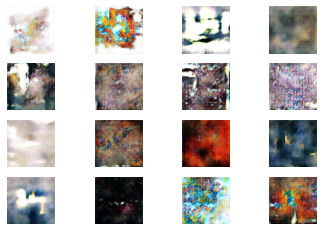



epoch -> [154/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



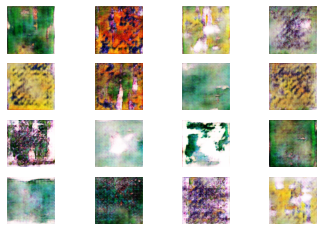



epoch -> [155/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



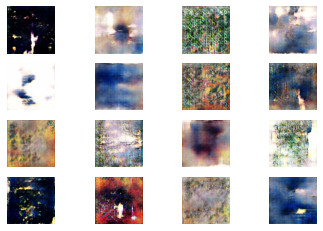



epoch -> [156/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



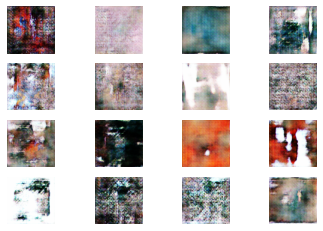



epoch -> [157/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



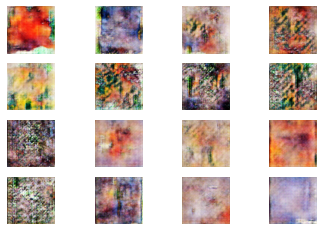



epoch -> [158/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



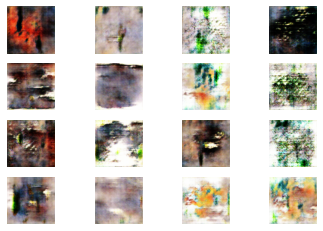



epoch -> [159/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



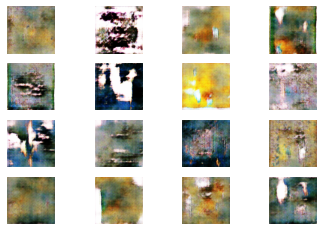



epoch -> [160/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



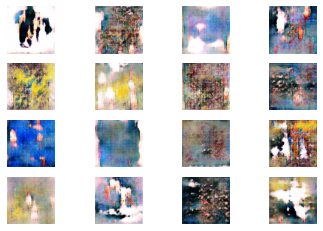



epoch -> [161/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



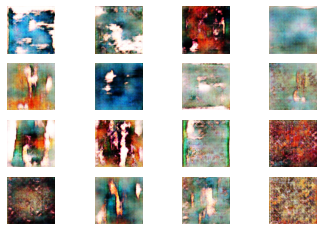



epoch -> [162/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



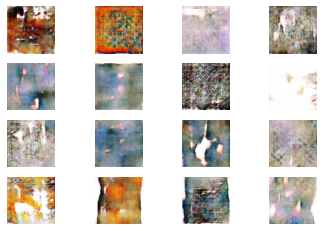



epoch -> [163/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



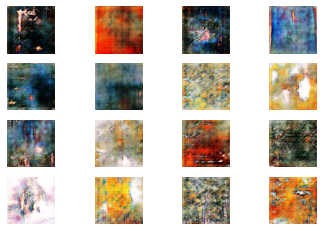



epoch -> [164/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



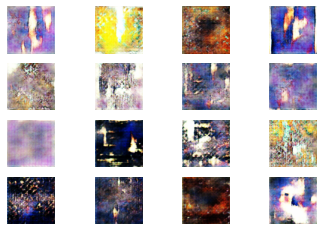



epoch -> [165/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



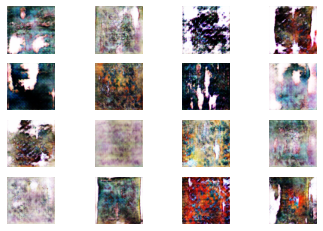



epoch -> [166/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



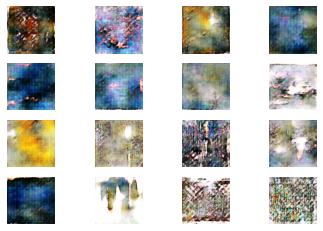



epoch -> [167/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



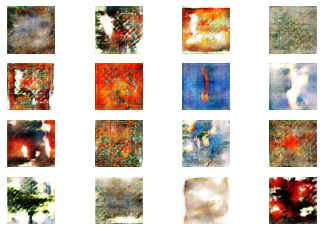



epoch -> [168/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



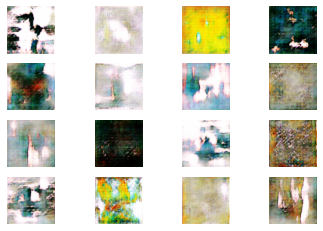



epoch -> [169/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



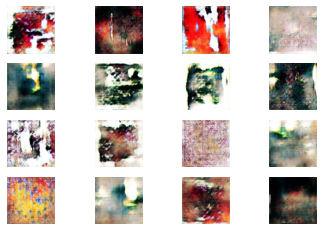



epoch -> [170/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



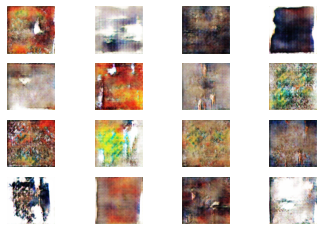



epoch -> [171/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



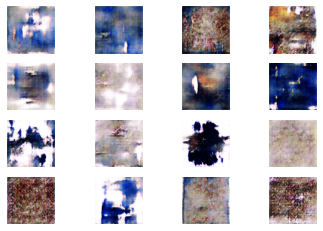



epoch -> [172/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



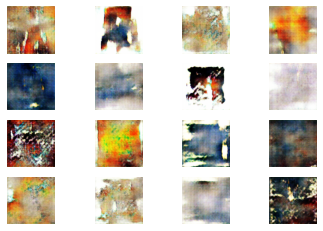



epoch -> [173/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



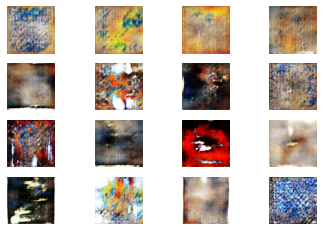



epoch -> [174/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



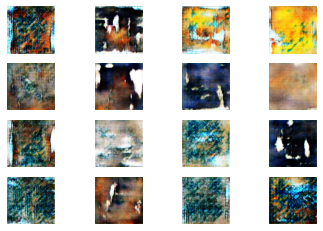



epoch -> [175/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



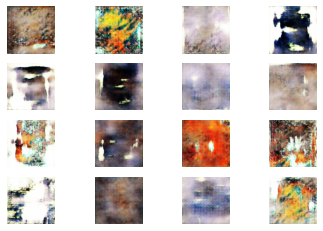



epoch -> [176/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



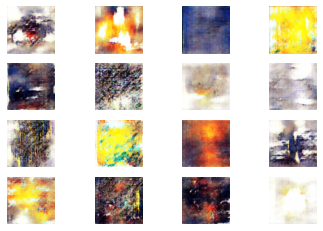



epoch -> [177/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



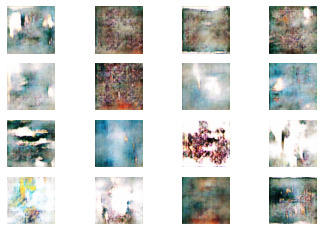



epoch -> [178/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



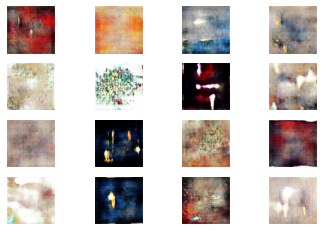



epoch -> [179/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



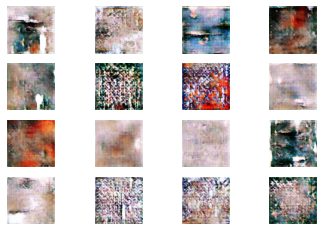



epoch -> [180/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



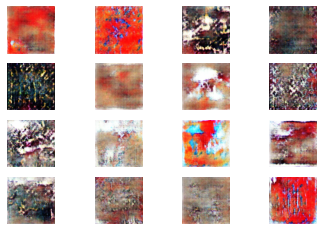



epoch -> [181/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



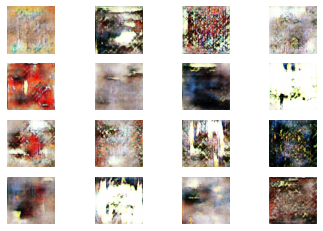



epoch -> [182/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



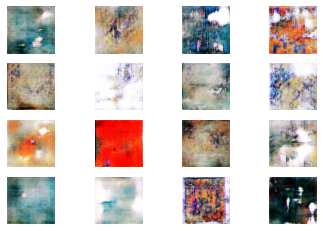



epoch -> [183/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



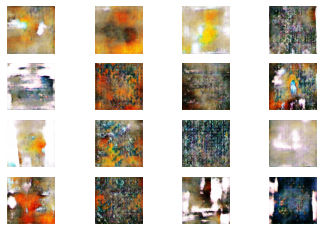



epoch -> [184/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



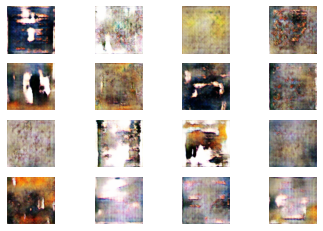



epoch -> [185/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



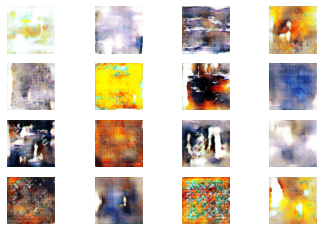



epoch -> [186/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



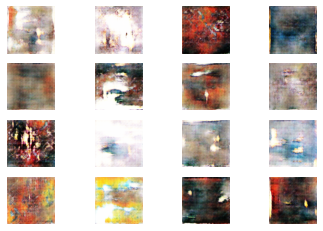



epoch -> [187/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



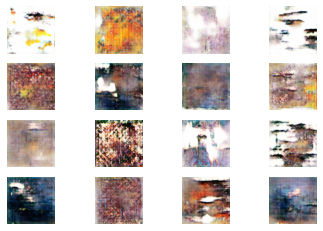



epoch -> [188/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



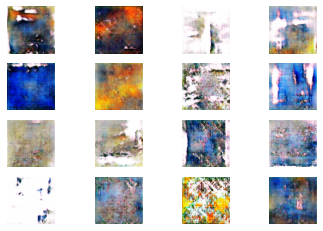



epoch -> [189/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



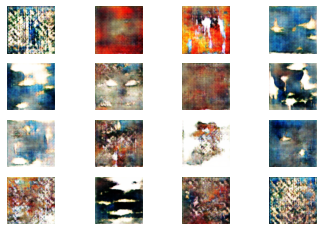



epoch -> [190/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



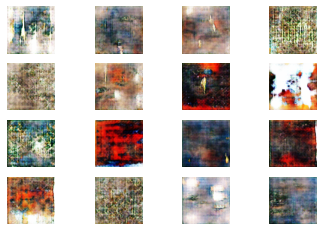



epoch -> [191/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



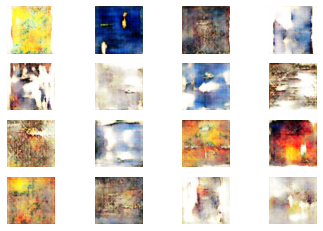



epoch -> [192/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



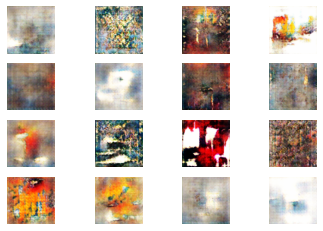



epoch -> [193/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



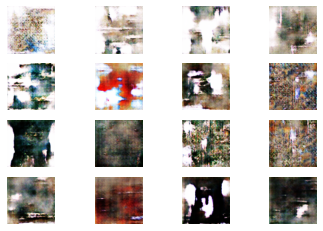



epoch -> [194/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



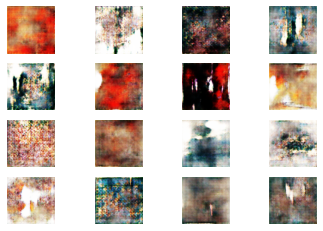



epoch -> [195/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



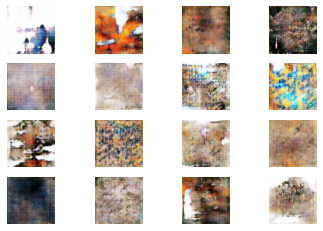



epoch -> [196/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



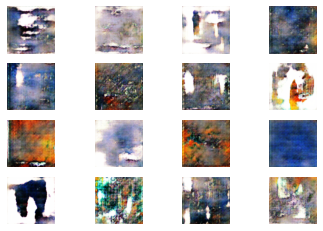



epoch -> [197/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



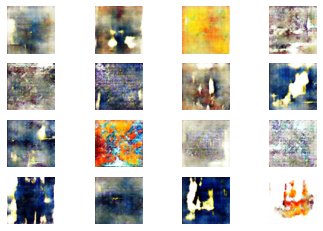



epoch -> [198/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



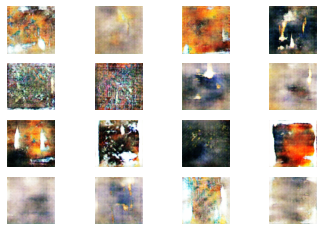



epoch -> [199/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



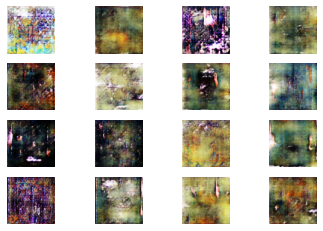



epoch -> [200/200], discriminator_loss_for_real_data = 0.02, discriminator_loss_for_fake_data = 0.01, generator_loss = 0.01



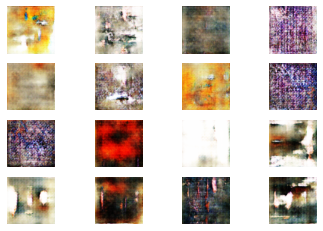

In [114]:
with tf.device(device_name):

  latent_dim = 512
  n_epochs = 200
  n_batch = 32
  d_model = define_discriminator()
  g_model = define_generator(latent_dim)
  gan_model = define_gan(g_model, d_model)
  # dataset = load_real_samples()
  print('\nREADY TO GO !!!\n')
  
  d_loss_real_array, d_loss_fake_array, g_loss_array = train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs, n_batch)

## Plot Loss Values

In [124]:
loaded = np.load('/content/drive/MyDrive/GAN_New_Approch/LSGAN_Abstract_1/loss_record.npz')
print(loaded['a'].shape)
print(loaded['b'].shape)
print(loaded['c'].shape)

(200,)
(200,)
(200,)


In [125]:
import matplotlib.pyplot as plot

d_loss_real_array = loaded['a']
d_loss_fake_array = loaded['b']

In [126]:
d_loss = np.array([(i+j) for i,j in zip(d_loss_real_array, d_loss_fake_array)])

In [127]:
g_loss = loaded['c']

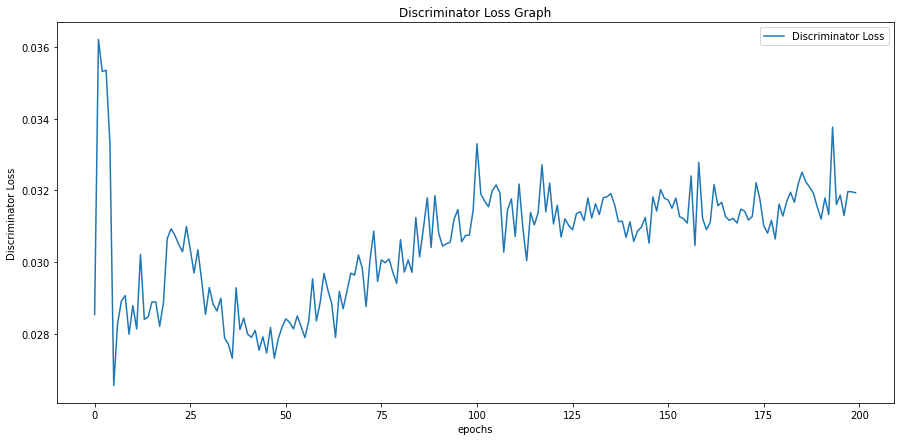

In [129]:
plt.figure(figsize=(15,7))
plt.plot(d_loss)
plt.title('Discriminator Loss Graph')
plt.ylabel('Discriminator Loss')
plt.xlabel('epochs')
plt.legend(["Discriminator Loss"], loc='upper right')
plt.savefig("/content/drive/MyDrive/GAN_New_Approch/LSGAN_Abstract_1/Discriminator_Loss_Graph")
plt.show()

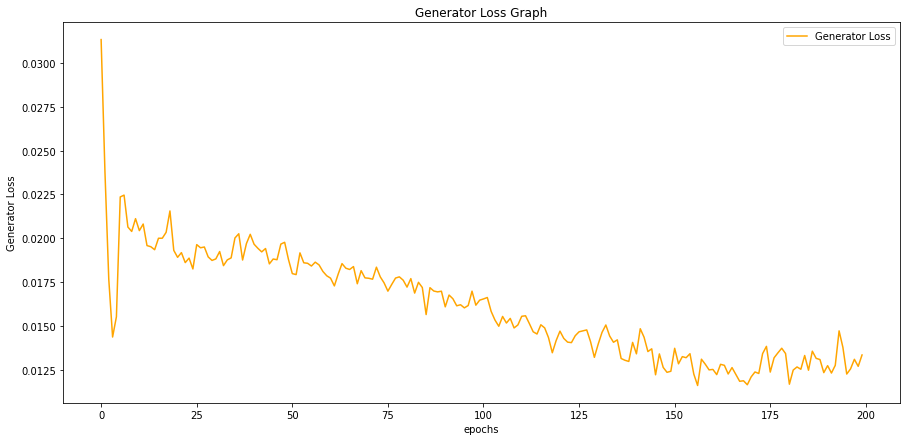

In [130]:
plt.figure(figsize=(15,7))
plt.plot(g_loss,color='orange')
plt.title('Generator Loss Graph')
plt.ylabel('Generator Loss')
plt.xlabel('epochs')
plt.legend(["Generator Loss"], loc='upper right')
plt.savefig("/content/drive/MyDrive/GAN_New_Approch/LSGAN_Abstract_1/Generator_Loss_Graph")
plt.show()

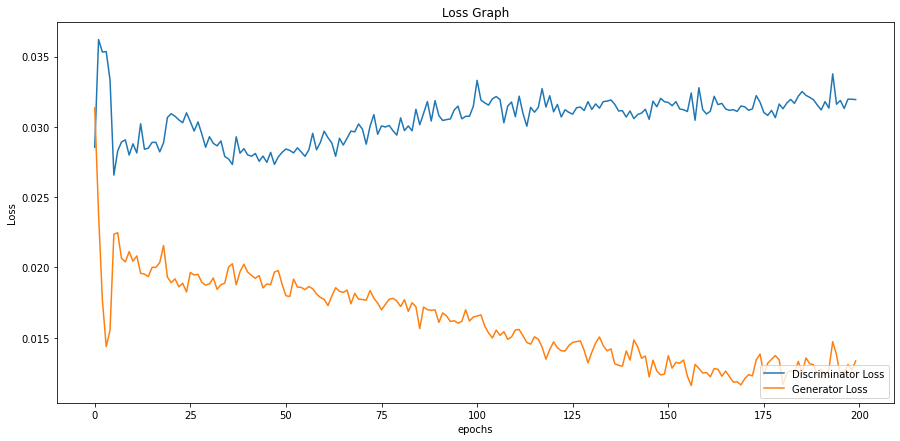

In [131]:
plt.figure(figsize=(15,7))
plt.plot(d_loss)
plt.plot(g_loss)
plt.title('Loss Graph')
plt.ylabel('Loss')
plt.xlabel('epochs')
plt.legend(["Discriminator Loss", "Generator Loss"], loc='lower right')
plt.savefig("/content/drive/MyDrive/GAN_New_Approch/LSGAN_Abstract_1/Loss_Graph")
plt.show()

# Prediction

In [132]:
generator = tensorflow.keras.models.load_model("/content/drive/MyDrive/GAN_New_Approch/LSGAN_Abstract_1/generator_model.h5")

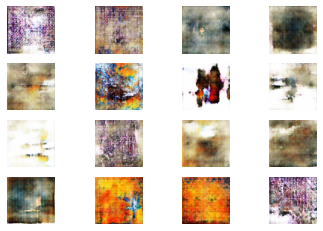

In [136]:
latent_dim = 512
n_samples = 16
z_input, labels = generate_latent_points(latent_dim, n_samples)
# print("latent points(latent points and labels): ",z_input.shape, labels.shape)
data = [z_input,labels]
pred = generator.predict(data)
pred = (pred + 1 ) / 2.0
# print("\nGenerated images with labels: ",pred.shape,'\n')
# plt.figure(figsize=(15,7))
save_plot(pred,n=4)
# plt.imshow(pred[0])
# plt.show()

                                              -:END:-